Code adapted from https://www.andersle.no/posts/2022/mo/mo.html#visualizing-the-orbitals-with-py3dmol-and-fortecubeview

MIT License

Copyright (c) 2022 andersle

In [1]:
!pip install rdkit
!pip install py3Dmol
!pip install fortecubeview
!pip install pythreejs
!pip install pyscf

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.1/36.1 MB 20.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 33.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 271.7/271.7 kB 21.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 61.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.2/51.2 MB 19.1 MB/s eta 0:00:00


In [2]:
import pathlib
from rdkit import Chem
from rdkit.Chem import (
    AllChem,
    rdCoordGen,
)
from rdkit.Chem.Draw import IPythonConsole

IPythonConsole.ipython_useSVG = True  # Use higher quality images for molecules

import py3Dmol
import fortecubeview

from pyscf import gto, scf, lo, tools

import matplotlib
from matplotlib import pyplot as plt
import seaborn as sns

%matplotlib inline
sns.set_theme(style="ticks", context="talk", palette="muted")

import numpy as np
import pandas as pd

pd.options.display.float_format = "{:,.3f}".format

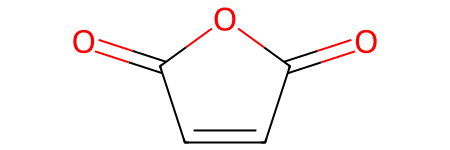

In [3]:
molecule_name = "maleic anhydride"
molecule = Chem.MolFromSmiles("C1=CC(=O)OC1=O")  # Generate the molecule from smiles
molecule

In [4]:
def get_xyz(molecule, optimize=False):
    """Get xyz-coordinates for the molecule"""
    mol = Chem.Mol(molecule)
    mol = AllChem.AddHs(mol, addCoords=True)
    AllChem.EmbedMolecule(mol)
    if optimize:
        AllChem.MMFFOptimizeMolecule(mol)
    xyz = []
    for lines in Chem.MolToXYZBlock(mol).split("\n")[2:]:
        strip = lines.strip()
        if strip:
            xyz.append(strip)
    xyz = "\n".join(xyz)
    return mol, xyz

In [5]:
molecule3d, xyz = get_xyz(molecule)

In [6]:
def run_calculation(xyz, basis):
    """Calculate the energy (+ additional things like MO coefficients) with pyscf."""
    mol = gto.M(
        atom=xyz,
        basis=basis,
        unit="ANG",
        symmetry=True,
    )
    mol.build()
    mf = scf.RHF(mol).run()
    return mf, mol

In [7]:
mf, mol = run_calculation(xyz, "sto-3g")

converged SCF energy = -372.258181798285


In [8]:
table = pd.DataFrame({"Energy": mf.mo_energy, "Occupancy": mf.mo_occ})
table

,Energy,Occupancy
0,-20.355,2.000
1,-20.306,2.000
2,-20.301,2.000
3,-11.200,2.000
4,-11.198,2.000
5,-11.087,2.000
6,-11.086,2.000
7,-1.423,2.000
8,-1.333,2.000
9,-1.295,2.000


In [9]:
def get_mo(mf, mol):
    """Get molecular orbitals"""
    orbitals = {"canonical": mf.mo_coeff}
    return orbitals

In [10]:
orbitals = get_mo(mf, mol)

In [11]:
def write_all_coeffs(
    mol, coeffs, prefix="cmo", dirname=".", margin=5, offset=0
):
    """Write cube files for the given coefficients."""
    path = pathlib.Path(dirname)
    path.mkdir(parents=True, exist_ok=True)

    for i in range(coeffs.shape[1]):
        outfile = f"{prefix}_{i+offset:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        tools.cubegen.orbital(mol, outfile, coeffs[:, i], margin=margin)

In [12]:
def find_homo_lumo(mf):
    lumo = float("inf")
    lumo_idx = None
    homo = -float("inf")
    homo_idx = None
    for i, (energy, occ) in enumerate(zip(mf.mo_energy, mf.mo_occ)):
        if occ > 0 and energy > homo:
            homo = energy
            homo_idx = i
        if occ == 0 and energy < lumo:
            lumo = energy
            lumo_idx = i

    return homo, homo_idx, lumo, lumo_idx


_, homo_idx, _, lumo_idx = find_homo_lumo(mf)
print(f"HOMO (index): {homo_idx}")
print(f"LUMO (index): {lumo_idx}")

HOMO (index): 24
LUMO (index): 25


In [13]:
tools.cubegen.orbital(
    mol, "cmo_lumo.cube", orbitals["canonical"][:, lumo_idx], margin=5
)

array([[[-1.03300444e-13, -1.42166472e-13, -1.92828004e-13, ...,
          2.66090919e-14,  1.75357641e-14,  1.14313784e-14],
        [-1.79712760e-13, -2.46181117e-13, -3.32029734e-13, ...,
          4.73025302e-14,  3.11728087e-14,  2.03210221e-14],
        [-3.05423104e-13, -4.15820691e-13, -5.56603796e-13, ...,
          8.25969882e-14,  5.44319729e-14,  3.54830029e-14],
        ...,
        [-9.14575501e-15, -1.27582247e-14, -1.75716183e-14, ...,
          5.26273142e-15,  3.49144820e-15,  2.29142174e-15],
        [-5.14876679e-15, -7.18171540e-15, -9.89006541e-15, ...,
          2.97315870e-15,  1.97245245e-15,  1.29449465e-15],
        [-2.84754255e-15, -3.97144732e-15, -5.46850399e-15, ...,
          1.65000226e-15,  1.09462867e-15,  7.18380613e-16]],

       [[-2.17090644e-13, -2.98360191e-13, -4.03979245e-13, ...,
          5.51306734e-14,  3.63373280e-14,  2.36913012e-14],
        [-3.76588027e-13, -5.14768066e-13, -6.92398785e-13, ...,
          9.80050775e-14,  6.45960272e

In [14]:
fortecubeview.plot(path=".", sumlevel=0.85)

CubeViewer: listing cube files from the directory .
Reading 1 cube file


HTML(value='\n        <style>\n           .jupyter-widgets-output-area .output_scroll {\n                heigh…

interactive(children=(Select(description='Cube files:', options=('./cmo_lumo.cube',), value='./cmo_lumo.cube')…

In [15]:
data = None
with open("cmo_lumo.cube", "r") as infile:
    data = infile.read()

In [16]:
view = py3Dmol.view()

# Style the atoms and bonds
view.setStyle({"stick": {}})

view.addVolumetricData(
    data,
    "cube",
    {
        "isoval": 0.05,
        "smoothness": 5,
        "opacity": 0.8,
        "volformat": "cube",
        "color": "orange",
    },
)
view.addVolumetricData(
    data,
    "cube",
    {
        "isoval": -0.05,
        "smoothness": 5,
        "opacity": 0.8,
        "volformat": "cube",
        "color": "blue",
    },
)
view.addModel(data, "cube")
view.setStyle({"stick": {}})
view.zoomTo()
view.show()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.